In [2]:
pip install PyWavelets

  Using cached PyWavelets-1.4.1-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (6.9 MB)
Note: you may need to restart the kernel to use updated packages.


In [1]:
from scipy.io import loadmat
import numpy as np
import matplotlib.pyplot as plt
S1_E1_A1 = loadmat('s1/S1_E1_A1.mat')
S1_E2_A1 = loadmat('s1/S1_E2_A1.mat')
S1_E3_A1 = loadmat('s1/S1_E3_A1.mat')
#axes will be time and emg value. still have to resolve channels, trials, and stims. 
#colors: trials
#rows: one stim per row.
#columns: one channel per column.
#S1_E1_A1
emg = S1_E1_A1['emg']
#S1_E1_A1
#np.shape(emg)
np.shape(emg[0:5].T)

(16, 5)

Result of the following:

16 channels

72 chunks

n = 446

tensor is t_coeffs with coeffs, t_data with raw data. labels is labels

In [26]:
#preparation of NN input tensors and time-domain plotting

import pywt
#import PyWavelets
wavelet = pywt.Wavelet('db1')
raw_repetition_stimulus = np.array((S1_E1_A1['rerepetition'], S1_E1_A1['restimulus']))

raw_repetition_stimulus = raw_repetition_stimulus.reshape(2, 130267)
repetition_stimulus = (raw_repetition_stimulus.T[(raw_repetition_stimulus[0] != 0) & (raw_repetition_stimulus[1] != 0)]).T


start = 0
emg = np.array(emg)
to_graph = [[] for _ in range(12)]
min_num_samples = 10000000000
for stim_number in range(1,13):
    for trial_number in range(1,7):
        num_samples = len(repetition_stimulus.T[(repetition_stimulus[0] == trial_number) & (repetition_stimulus[1] == stim_number)])
        min_num_samples = min(min_num_samples, num_samples)
        
        y = emg[(start):(start + num_samples)].T
        to_graph[stim_number - 1].append(y)
        start = start + num_samples

to_stack1 = []
to_stack2 = []
labels = []
for stim_number in range(1,13):
    stim_index = stim_number - 1
    for trial_number in range(1,7):
        trial_index = trial_number - 1
        chunk = to_graph[stim_index][trial_index].T
        to_add_preT = chunk[0:min_num_samples]
        to_add = to_add_preT.T
        # tensors for NN input :
        (to_add_data, to_add_coeffs) = pywt.dwt(to_add, 'db1', mode="per")
        to_stack1.append(to_add_coeffs)
        to_stack2.append(to_add)
        labels.append(stim_number)
#[print(np.shape(_)) for _ in to_stack]
#print(len(to_stack))
#print(len(labels))
t_coeffs = np.stack(to_stack1, axis=0) 
t_data = np.stack(to_stack2, axis=0)

print("shape of coeffs tensor" , np.shape(t_coeffs), len(labels))

print("shape of data tensor" , np.shape(t_data), len(labels))

print(labels)

shape of coeffs tensor (72, 16, 223) 72
shape of data tensor (72, 16, 446) 72
[1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 10, 10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 12]


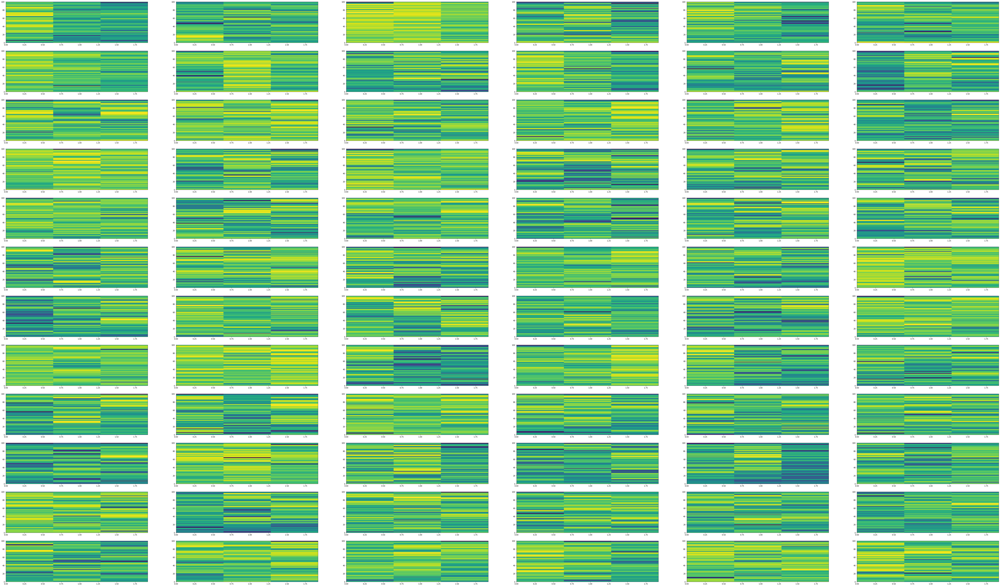

In [45]:
#spectrograms!
fig, ax = plt.subplots(12, 6, figsize=(100,60))


for stim_number in range(1,13):
    stim_index = stim_number - 1
    for trial_number in range(1,7):
        trial_index = trial_number - 1
        chunk = to_graph[stim_index][trial_index].T
        to_add_preT = chunk[0:min_num_samples]
        to_add = to_add_preT.T
        #following was for chunked wavelet visualization:
        chunk_size = len(to_add_preT) // 8
        
        for i in range(8):
            (to_add_data, to_add_coeffs) = pywt.dwt(to_add[0], 'db1', mode="per")
            #print(np.shape(to_add_data))
            spectrum, freqs, midpoint_times, img = ax[stim_index,trial_index].specgram(to_add[0], NFFT=128, Fs=200, noverlap=0)
            #ax[stim_index, trial_index].plot(to_add_coeffs)
plt.show()       


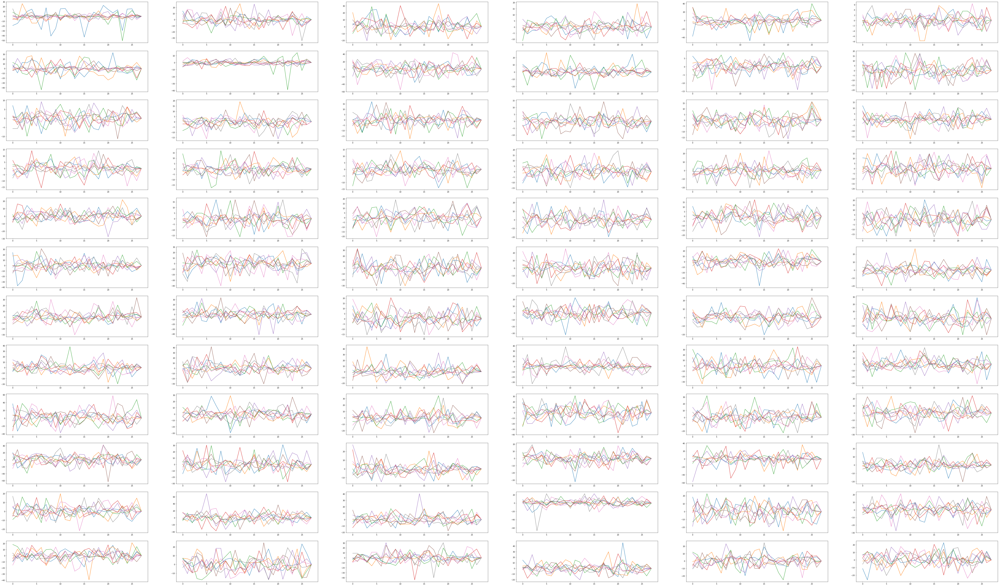

In [21]:
# 1 channel, 8 chunks different colors. wavelets.
fig, ax = plt.subplots(12, 6, figsize=(100,60))

for stim_number in range(1,13):
    stim_index = stim_number - 1
    for trial_number in range(1,7):
        trial_index = trial_number - 1
        chunk = to_graph[stim_index][trial_index].T
        to_add_preT = chunk[0:min_num_samples]
        to_add = to_add_preT.T
        #following was for chunked wavelet visualization:
        chunk_size = len(to_add_preT) // 8
        
        for i in range(8):
            pre_dwt = ((to_add_preT[(i*chunk_size): ((i+1)*(chunk_size))]).T)[0]
            (to_add_data, to_add_coeffs) = pywt.dwt(pre_dwt, 'db1', mode="per")
            
            ax[stim_index, trial_index].plot(to_add_coeffs)
        

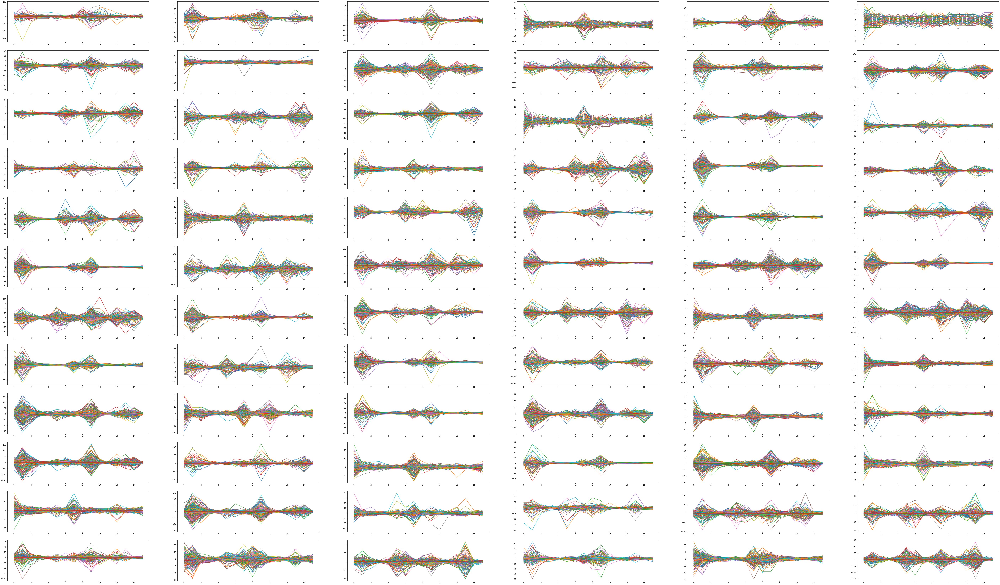

In [30]:
#default (both channels and chunks on each graph)
fig, ax = plt.subplots(12, 6, figsize=(100,60))
for stim_number in range(1,13):
    stim_index = stim_number - 1
    for trial_number in range(1,7):
        trial_index = trial_number - 1
        chunk = to_graph[stim_index][trial_index].T
        to_add_preT = chunk[0:min_num_samples]
        to_add = to_add_preT.T
        chunk_size = len(to_add_preT) // 8
        #one chunk (all of it), all channels
        for i in range(8):
            pre_dwt = ((to_add_preT[(i*chunk_size): ((i+1)*(chunk_size))]).T)
            (to_add_data, to_add_coeffs) = pywt.dwt(pre_dwt, 'db1', mode="per")
            ax[stim_index, trial_index].plot(to_add_coeffs)

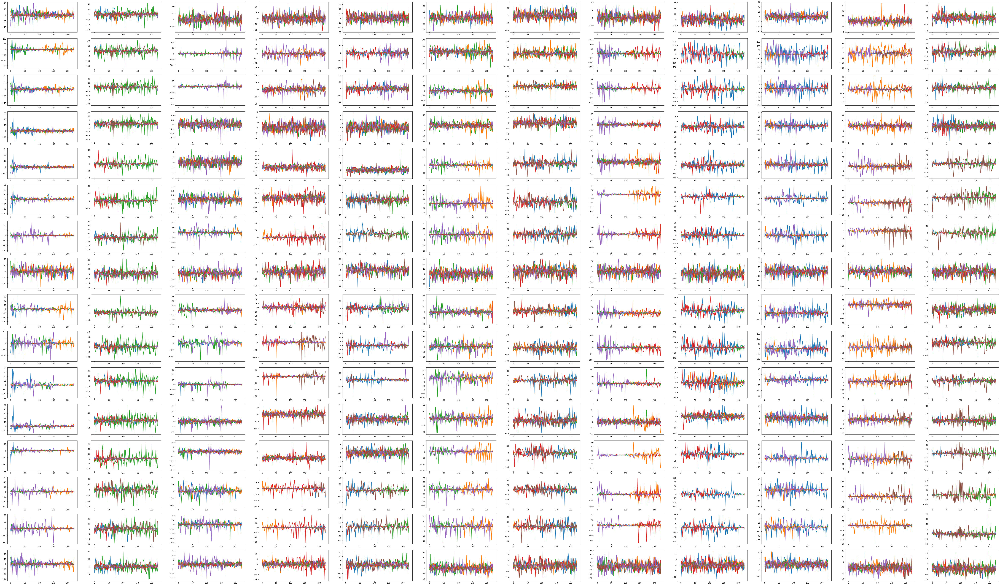

In [41]:
#comparing channels' wavelets visualization - channels separated
#n is choosing which chunk to visualize
#plotting each channel separately for clarity
fig, ax = plt.subplots(16, 12, figsize=(100,60))
n = 0
for stim_number in range(1,13):
    stim_index = stim_number - 1
    for trial_number in range(1,7):
        trial_index = trial_number - 1
        chunk = to_graph[stim_index][trial_index].T
        to_add_preT = chunk[0:min_num_samples]
        to_add = to_add_preT.T
        chunk_size = len(to_add_preT) // 1
        #one chunk (all of it), all channels
        for i in range(16):
            pre_dwt = ((to_add_preT[(n*chunk_size): ((n+1)*(chunk_size))]).T)[i]
            (to_add_data, to_add_coeffs) = pywt.dwt(pre_dwt, 'db1', mode="per")
            ax[i, stim_index].plot(to_add_coeffs)
        

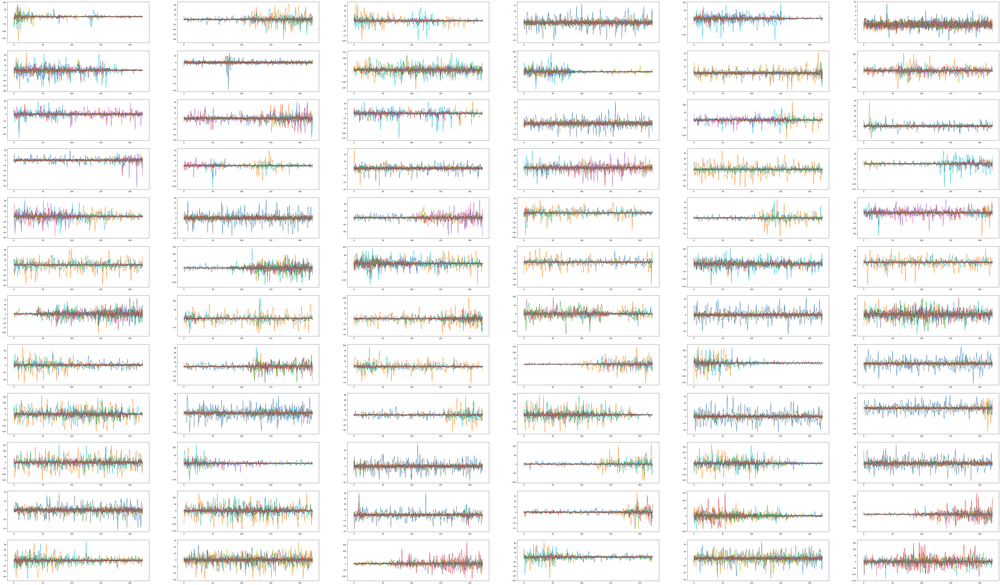

In [40]:
#comparing channels' wavelets visualization - trials separated
#n is choosing which chunk to visualize
fig, ax = plt.subplots(12, 6, figsize=(100,60))
n = 0
for stim_number in range(1,13):
    stim_index = stim_number - 1
    for trial_number in range(1,7):
        trial_index = trial_number - 1
        chunk = to_graph[stim_index][trial_index].T
        to_add_preT = chunk[0:min_num_samples]
        to_add = to_add_preT.T
        chunk_size = len(to_add_preT) // 1
        #one chunk (all of it), all channels
        for i in range(16):
            pre_dwt = ((to_add_preT[(n*chunk_size): ((n+1)*(chunk_size))]).T)[i]
            (to_add_data, to_add_coeffs) = pywt.dwt(pre_dwt, 'db1', mode="per")
            ax[stim_index, trial_index].plot(to_add_coeffs)
        

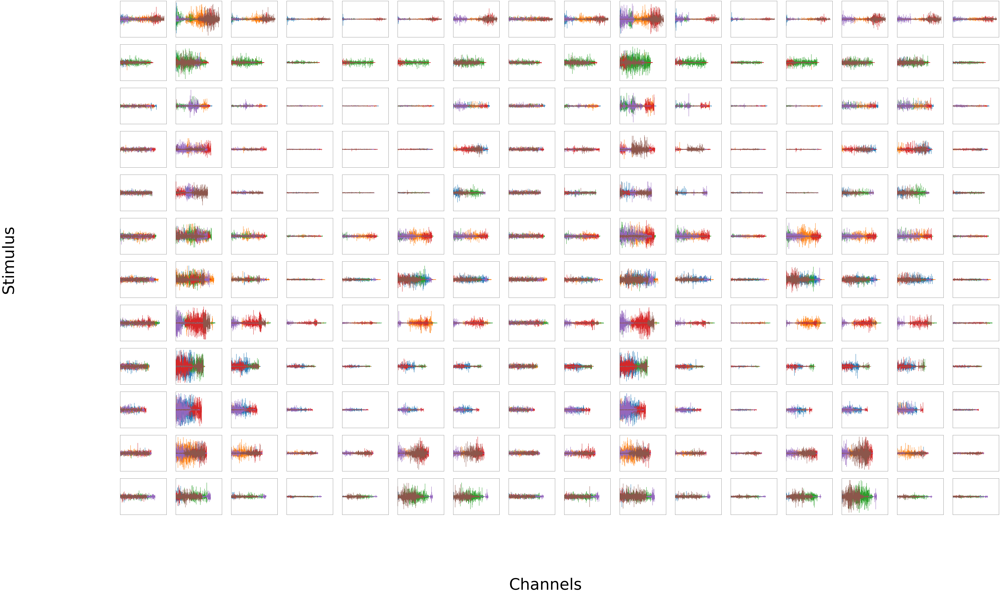

In [4]:
#each row shows one stimulus, all channels. time domain
def visualize_emg(stim_indices, channel_indices, trial_indices): 
    fig, ax = plt.subplots(len(stim_indices), len(channel_indices), figsize=(100,60), sharex=True, sharey=True)
    for stim in stim_indices:
        for chan in channel_indices:
            
            if len(stim_indices) == 1 and len(channel_indices) == 1:
                axis = ax
            elif len(channel_indices) == 1: 
                axis = ax[stim]
            elif len(stim_indices) == 1:
                axis = ax[chan]
            else:
                axis = ax[stim, chan]
                
            for trial_number in trial_indices:
                axis.plot(to_graph[stim][trial_number][chan])
            axis.set_xticks([])
            axis.set_yticks([])
    fig.supxlabel('Channels', fontsize=100)
    fig.supylabel('Stimulus', fontsize=100)
    plt.xlim(0,)
    plt.show()

visualize_emg(range(12), range(16), range(6))
#visualize_emg([1]

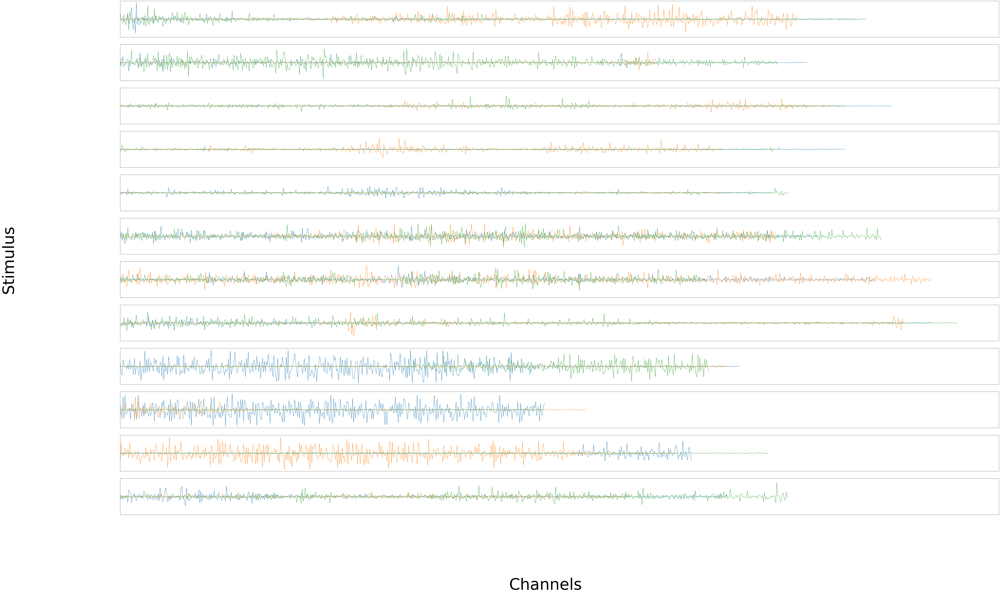

In [5]:
visualize_emg(range(12), [1], range(3)) 

In [ ]:
#feature extraction

#12 conventional features
#IEMG
def iemg(signal):
    abs_x = abs(signal)
    return sum(abs_x)
#MAV
def mav(signal):
    return iemg(signal)/len(signal)
#SSI
def ssi(signal):
    sq_x = signal ** 2
    return sum(sq_x)
#RMS
def rms(signal):
    return sqrt(ssi(signal)/len(signal)
#VAR
def var(signal):
    return ssi(signal)/(len(signal)-1)
#MYOP
def myop(signal, T):
    return sum([1 for point in signal if abs(point)>T])/len(signal)
#WL
def wl(signal):
    return sum([abs(signal[n+1] - signal[n]) for n in range(len(signal) - 1)])
#DAMV
def damv(signal):
    return wl(signal)/(len(signal)-1)
#M2
def m2(signal):
    return sum([(signal[n+1] - signal[n])**2 for n in range(len(signal) - 1)])
#DVARV
def dvarv(signal):
    return m2(signal)/(len(signal)-2)
#DASDV
def dasdv(signal):
    return sqrt(m2(signal)/(len(signal)-1))
#WAMP
def wamp(signal):
    return sum([1 for n in range(len(signal)-1) if abs(signal[n+1] - signal[n])>T])
                
#Additional features
def iasd(signal):
    signal = np.diff(signal)
    return sum([abs(signal[n+1] - signal[n]) for n in range(len(signal) - 1)])
    
                
def 

In [ ]:
#CNN